<a href="https://colab.research.google.com/github/LuizJoca/Sandstone_Image_Analysis/blob/main/P1_GA120A.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font color=green> **RESERVOIR GEOLOGICAL CHARACTERIZATION - IMAGE STUDY**

**Elaborado por:** Luiz Henrique Joca Leite

**RA**: 184485

Esse *notebook* constitui a primeira atividade a ser entregue para avaliação da disciplina **GA120A - Caracterização Geológica de Reservatórios**.

No código abaixo tentou-se operacionalizar as seguintes tarefas:
* Binarização automática de seção delgada de arenitos
* Representar de forma isolada os elementos que compõe a lâmina analisada (Grão, Poro e Cimento)
* Calcular o volume correspondente a cada um dos elementos supracitados
* Calcular a Volume Elementar Representativo da amostra analisada


# <font color = "Green"> **Instalação e ambiente de desenvolvimento**

### *Verificando Versão do Python*

In [ ]:
!python -V

Python 3.7.15


### *Instalando e Verificando a Versão das Bibliotecas*

In [ ]:
import cv2
import numpy as np
import matplotlib

from matplotlib import pyplot as plt
plt.style.use('seaborn')

In [ ]:
print('Versão do Numpy--> %s' % np.__version__)
print('Versão do OpenCV--> %s' % cv2.__version__)
print('Versão do Matplotlib--> %s' % matplotlib.__version__)

Versão do Numpy--> 1.21.6
Versão do OpenCV--> 4.6.0
Versão do Matplotlib--> 3.2.2


### *Importando o dado*

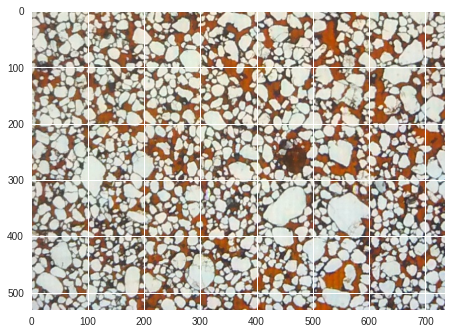

In [ ]:
#Importando a imagem
img = cv2.imread('/content/drive/MyDrive/Ga120A/Lamina_GeoRes.jpg')

plt.imshow(img)
plt.show()

Obs.: O OpenCV representa imagens RGB como arrays multidimensionais, porém com ordem inversa. Por isso é necessário converter a imagem importada em BGR para RGB

### *Plotando a imagem RGB*

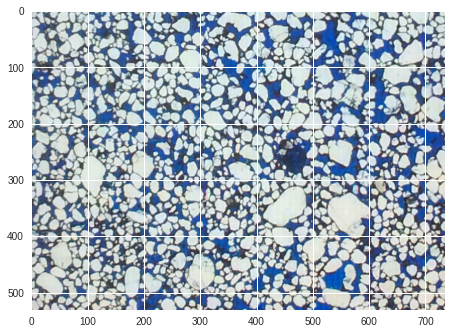

In [ ]:
rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(rgb)
plt.show()

### *Plotando a imagem em tons de cinza*

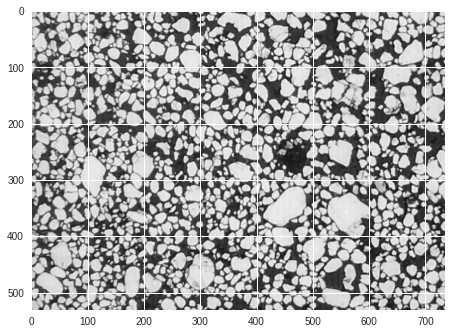

In [ ]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.imshow(gray, cmap = 'gray')
plt.show()

### *Plotando as duas imagens lado a lado*

In [ ]:
## Função para plotar multiplas imagens:
def plot_img(images, titles):
  fig, axs = plt.subplots(nrows = 1, ncols = len(images), figsize = (30, 25))
  for i, p in enumerate(images):
    axs[i].imshow(p, 'gray')
    axs[i].set_title(titles[i])
    #axs[i].axis('off')
  plt.show()

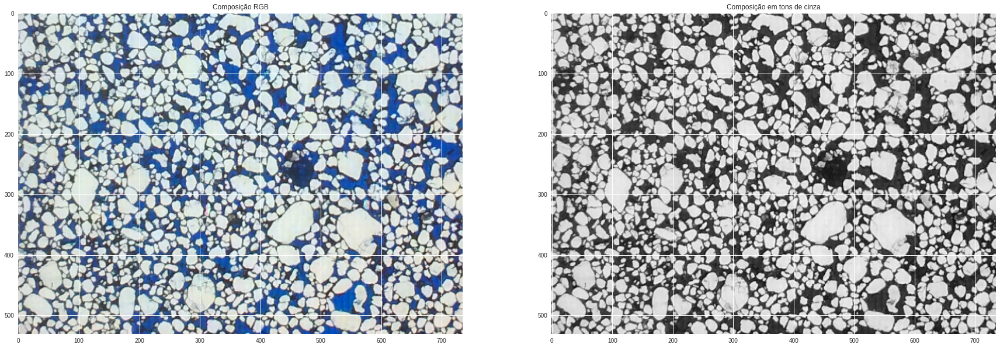

In [ ]:
images = [rgb, gray]
titles = ['Composição RGB', 'Composição em tons de cinza']

plot_img(images, titles)

# <font color = green> **1. Porosity, Grains, and Cement, volume calculation**

## <font color = green> ***1.1 Binarização aumotática via Otsu's Threshold***

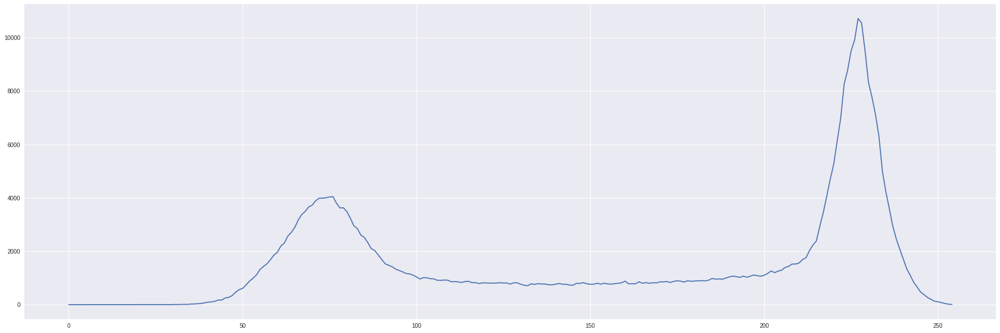

In [ ]:
#Plotando o histograma da imagem em tons de cinza:

plt.figure(figsize = (30, 10))

hist_gray = cv2.calcHist([gray], [0], None, [255], [0,255])
plt.plot(hist_gray)
plt.show()

A partir do histograma acima é possível observar dois picos importantes, o primeiro entre as regiões com pixels de valor localizado entre o intervalo de 50 e 100, aproximadamente, e o segundo com pixels com valor acima de 200, aproximadamente.

Nesse caso alguns desses limites poderia ser utilizado a fim de realizar o processo de binzarização da imagem.

Todavia, com o intuito de reduzir a subjetidade contida nesse processo, diversas bibliotecas possuem atualmente algorítimos de binarização automática de imagens, sendo o *Otsu's Threshold* da biblioteca OpenCV uma das mais amplamente utilizadas.

In [ ]:
#Binarizando a imagem em tons de cinza utilizando o Otsu's Threshold:

T, img_otsu = cv2.threshold(gray, 0, 255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

print("[INFO] Valor gerado pelo thresholding de otsu: {}". format(T))

[INFO] Valor gerado pelo thresholding de otsu: 151.0


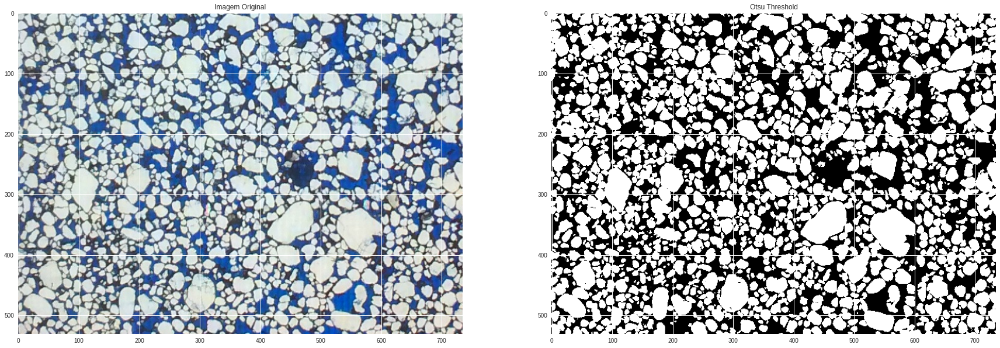

In [ ]:
#Plotando a imagem RGB (original) e a imagem binarizada:

plots = [rgb, img_otsu]
titles = ['Imagem Original', 'Otsu Threshold']

plot_img(plots, titles)

In [ ]:
min_otsu = np.array([0])
value_otsu = np.array([int(T)])
max_otsu = np.array([255])

## <font color = green> ***1.2 Mascarando os grãos***

In [ ]:
#Mascarando os grãos utilizando o valor de threshold, gerado automaticamente pelo Otsu's Threshold, e o valor máximo disponível para a imagem:

mask_grao = cv2.inRange(gray, value_otsu, max_otsu)
res_grao = cv2.bitwise_and(rgb, rgb, mask = mask_grao)

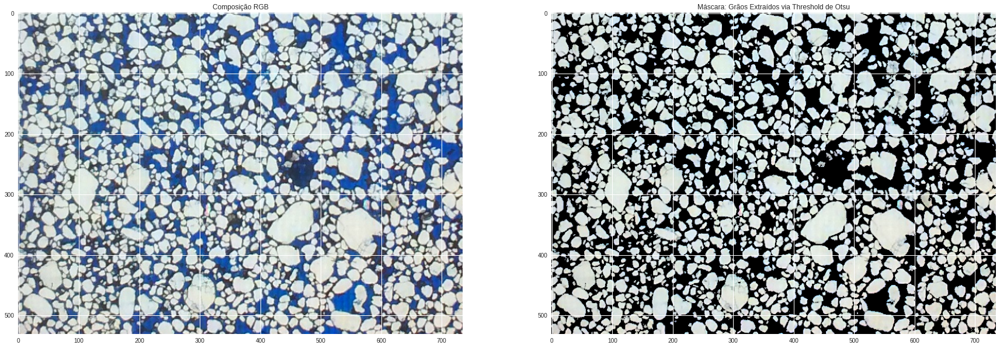

In [ ]:
#Plotando a imagem RGB (Original) e a versão após a aplicação da mascará para realce dos grãos:

gabarito_grao = [rgb, res_grao]
titles = ['Composição RGB', 'Máscara: Grãos Extraídos via Threshold de Otsu']

plot_img(gabarito_grao, titles)

## <font color = green> ***1.3 Mascarando os poros***

In [ ]:
#Mascarando os poros utilizando o valor mínimo disponível para a imagem e o valor de threshold, gerado automaticamente pelo Otsu's Threshold:

mask_poro = cv2.inRange(gray, min_otsu, value_otsu)
res_poro = cv2.bitwise_and(rgb, rgb, mask = mask_poro)

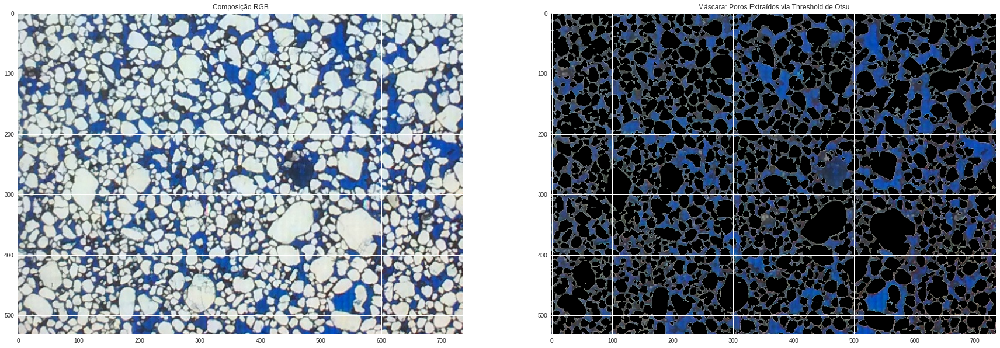

In [ ]:
#Plotando a imagem RGB (Original) e a versão após a aplicação da mascará para realce dos poros:

gabarito_poro = [rgb, res_poro]
titles = ['Composição RGB', 'Máscara: Poros Extraídos via Threshold de Otsu']

plot_img(gabarito_poro, titles)

O que se observa, entretanto, é que a utilização apenas dos valores extraídos automáticamente da binarização aglutina na mesma máscara os poros e cimento presente na imagem.

Nesse contexto, portanto, é necessário operacionalizar uma nova máscara a partir de um novo critério que permita separar estes elementos.

## <font color = green> ***1.4 Mascarando o cimento***

Uma das opções que podem axiliar na compreensão do comportamento desses elementos na imagem, seria analisar os canais da composição RGB separadamente

In [ ]:
r, g, b = cv2.split(rgb)

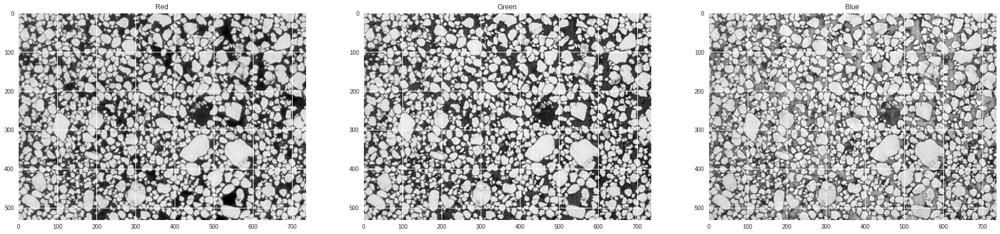

In [ ]:
channels = [r, g, b]
titles = ['Red', 'Green', 'Blue']

plot_img(channels, titles)

A partir da análise das imagens acima, observa-se um realce diferente nos pixels correspondentes às regiões onde há presença de cimento, para a imagem do canal Azul

In [ ]:
hist_r = cv2.calcHist([r], [0], None, [255], [0,255])
hist_g = cv2.calcHist([g], [0], None, [255], [0,255])
hist_b = cv2.calcHist([b], [0], None, [255], [0,255])

<function matplotlib.pyplot.show(*args, **kw)>

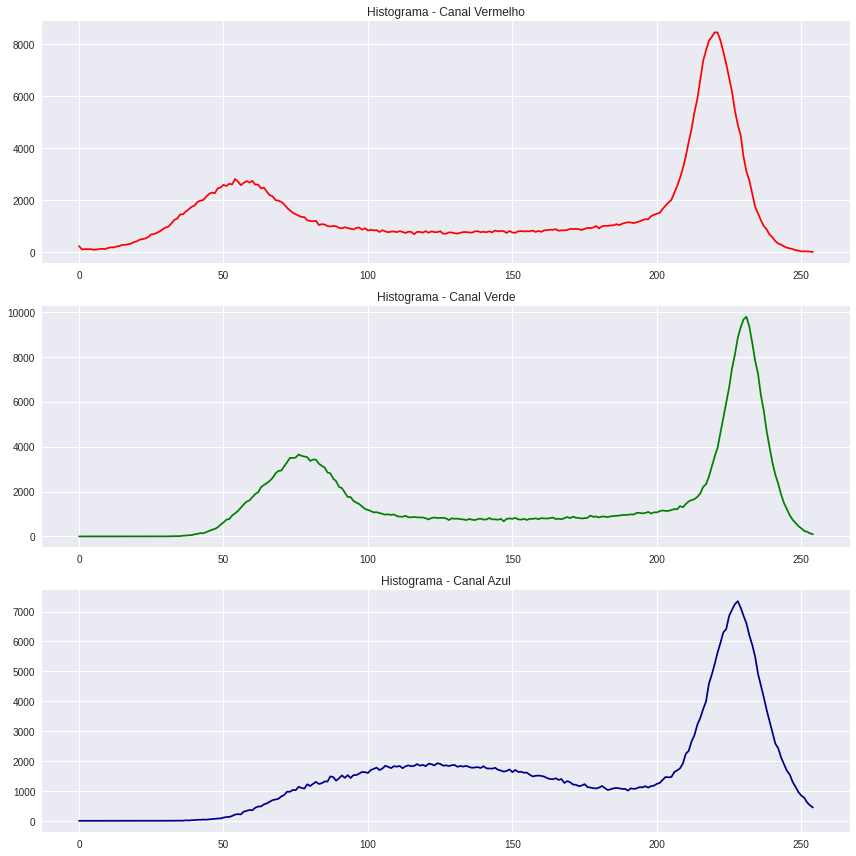

In [ ]:
plt.figure(figsize = (12, 12))

plt.subplot(3, 1, 1)
plt.title('Histograma - Canal Vermelho')
plt.plot(hist_r, color='red')

plt.subplot(3, 1, 2)
plt.title('Histograma - Canal Verde')
plt.plot(hist_g, color='green')

plt.subplot(3, 1, 3)
plt.title('Histograma - Canal Azul')
plt.plot(hist_b, color='darkblue')

plt.tight_layout()
plt.show

Observando o histograma de cada um dos canais analisados, de forma isolada, observa-se de fato, um comportamento diferente para o histograma do Canal Azul da imagem. Indicando que este talvez permita um isolamento melhor entre os poros e o cimento presentes na imagem.

In [ ]:
#Limite Inferior para extração da máscara do cimento
lower_blue = np.array([0])

#Possíveis Limites Superiores para extração de máscara do cimento, com base na análise do histograma acima:

upper_blue_a = np.array([90])
upper_blue_b = np.array([95])
upper_blue_c = np.array([100])

In [ ]:
mask_cimento_a = cv2.inRange(b, lower_blue, upper_blue_a)
res_a = cv2.bitwise_and(rgb, rgb, mask = mask_cimento_a)

mask_cimento_b = cv2.inRange(b, lower_blue, upper_blue_b)
res_b = cv2.bitwise_and(rgb, rgb, mask = mask_cimento_b)

mask_cimento_c = cv2.inRange(b, lower_blue, upper_blue_c)
res_c = cv2.bitwise_and(rgb, rgb, mask = mask_cimento_c)

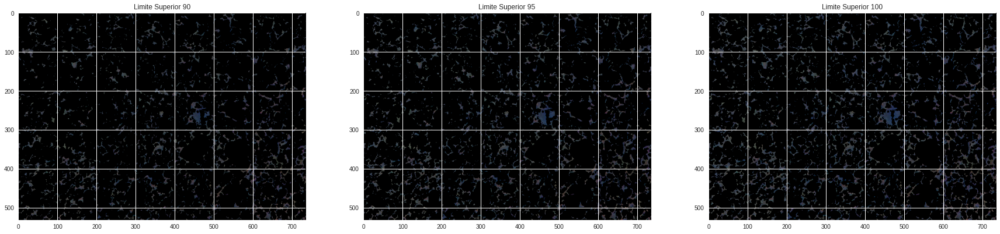

In [ ]:
mascaras_cimento = [res_a, res_b, res_c]
titles = ['Limite Superior 90', 'Limite Superior 95', 'Limite Superior 100']

plot_img(mascaras_cimento, titles)

Analisando as máscaras acima, geradas a partir dos limites superiores de 90, 95 e 100, respectivamente, conclui-se que o limite superior de 95 isola melhor os pixels correspondetes apenas ao cimento na amostra analisada 

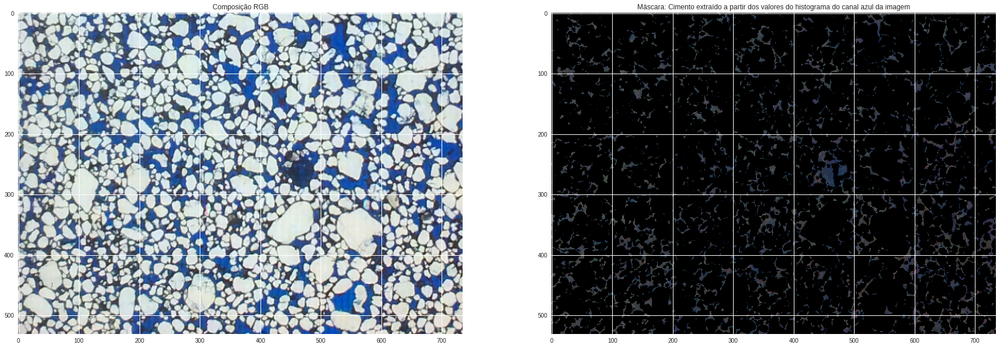

In [ ]:
mask_cimento = mask_cimento_b
res_cimento = res_b

#Plotando a imagem RGB (Original) e a versão após a aplicação da mascará para realce do cimento:

gabarito_cimento = [rgb, res_cimento]
titles = ['Composição RGB', 'Máscara: Cimento extraído a partir dos valores do histograma do canal azul da imagem']

plot_img(gabarito_cimento, titles)

## <font color = green> ***1.5 Re-Mascarando os poros***

Analisando novamente a máscara de poros extraída anteriormente tem-se que:

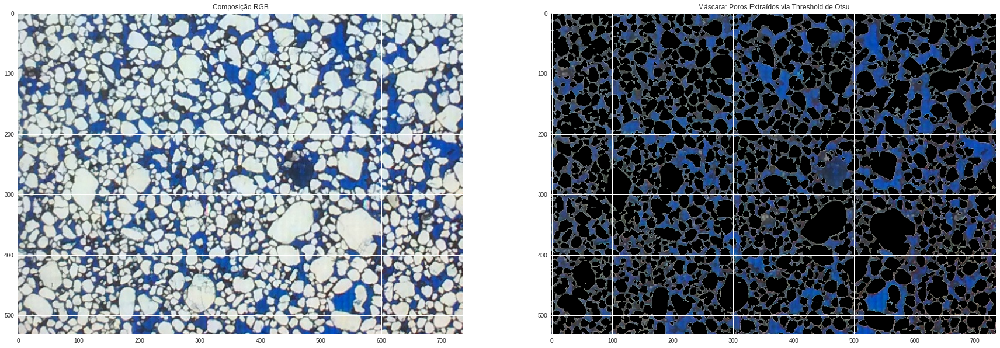

In [ ]:
gabarito_poro = [rgb, res_poro]
titles = ['Composição RGB', 'Máscara: Poros Extraídos via Threshold de Otsu']

plot_img(gabarito_poro, titles)

Analisando de forma comparativa a mascara extraída anteriormente para os poros, a partir da imagem binarizada automáticamente, junto a máscara extraída para o cimento, a partir dos valores de histograma do canal azul da composição original tem-se que:

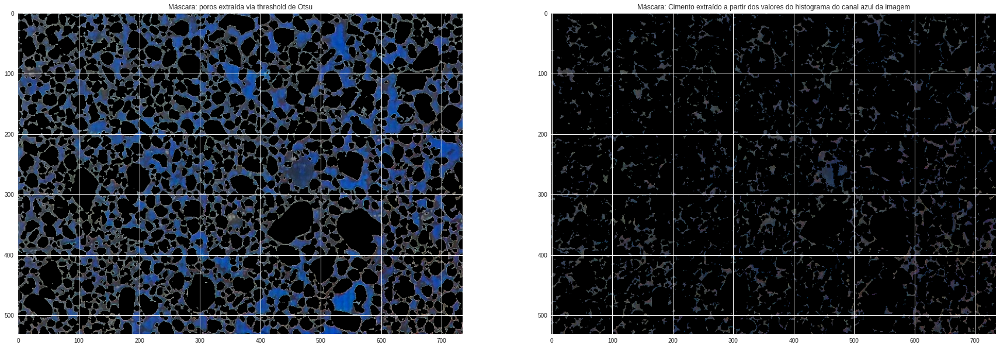

In [ ]:
mascaras= [res_poro, res_cimento]
titles = ['Máscara: poros extraída via threshold de Otsu', 'Máscara: Cimento extraído a partir dos valores do histograma do canal azul da imagem']

plot_img(mascaras, titles)

Nesse caso é possivél observar que, a junção da máscara de poros, extraída anteriormente, e de uma inversão da máscara de cimento recém extraída permite uma delimitação precisa dos poros da imagem, sendo assim:

In [ ]:
#Inversão da máscara de cimento extraída anteriormente, utilizando o limite superior extraído a partir da análise do histograma no canal azul, e o valor máximo da binarização de Otsu:

mask_cimento_inv = cv2.inRange(b, upper_blue_b, max_otsu)
res_cimento_inv = cv2.bitwise_and(rgb, rgb, mask = mask_cimento_inv)

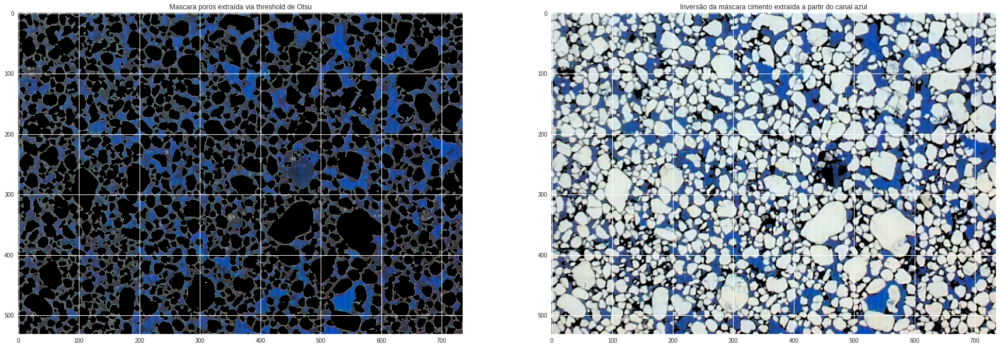

In [ ]:
#Plotando a máscara de poros, extraída via Otsu's Threshold, e a inversão da máscara para realce dos poros:

mascaras= [res_poro, res_cimento_inv]
titles = ['Mascara poros extraída via threshold de Otsu', 'Inversão da máscara cimento extraída a partir do canal azul']

plot_img(mascaras, titles)

In [ ]:
#Somam-se as duas máscaras:

mask_final = mask_poro & mask_cimento_inv

In [ ]:
mask_poro = mask_final

#Aplica-se a nova máscara na imagem original

res_poro = cv2.bitwise_and(rgb, rgb, mask = mask_poro)

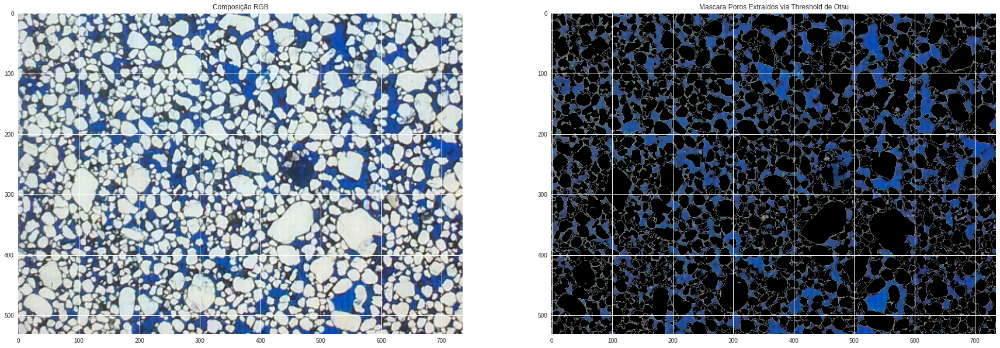

In [ ]:
#Plotando a imagem RGB (Original) e a nova versão após a aplicação da mascará para realce dos poros:

gabarito_poro = [rgb, res_poro]
titles = ['Composição RGB', 'Mascara Poros Extraídos via Threshold de Otsu']

plot_img(gabarito_poro, titles)

## <font color = green> ***1.6 Cálculo do volume***

Tendo em posse as máscaras capazes de isolar cada um dos elementos presentes na seção delgada analisada, é possível agora, estimar o volume de cada um dos elementos analisados na imagem:

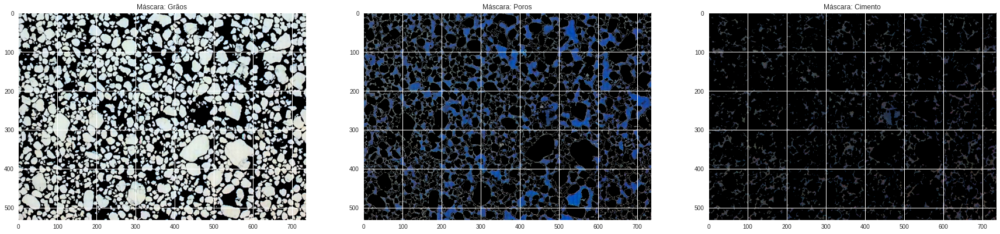

In [ ]:
mascaras = [res_grao, res_poro, res_cimento]
titles = ['Máscara: Grãos', 'Máscara: Poros', 'Máscara: Cimento']

plot_img(mascaras, titles)

In [ ]:
#Função para o calculo de volume:

def calcula_volume(mascara, item):
  total = img.shape[0]*img.shape[1]
  componente = np.count_nonzero(mascara == 0)
  porcentagem_componente = round((1 - (componente/total))*100)

  print(f"A porcentagem de {item} corresponde a {porcentagem_componente}% da lâmina analisada")

In [ ]:
volume_grao = calcula_volume(mask_grao, 'Grão')
volume_grao

A porcentagem de Grão corresponde a 58% da lâmina analisada


In [ ]:
volume_poro = calcula_volume(mask_poro, 'Poros')
volume_poro

A porcentagem de Poros corresponde a 32% da lâmina analisada


In [ ]:
volume_cimento = calcula_volume(mask_cimento, 'Cimento')
volume_cimento

A porcentagem de Cimento corresponde a 10% da lâmina analisada




# <font color = "green"> **2. Representative volume of porosity**

Porespy: https://typeset.io/papers/porespy-a-python-toolkit-for-quantitative-analysis-of-porous-1on0v92rk9

In [ ]:
!pip install porespy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import porespy as ps
import inspect
import seaborn as sns

In [ ]:
inspect.signature(ps.metrics.representative_elementary_volume)

<Signature (im, npoints=1000)>

In [ ]:
print('Versão do Porespy--> %s' % ps.__version__)
print('Versão do Seaborn--> %s' % sns.__version__)

Versão do Porespy--> 2.0.2
Versão do Seaborn--> 0.11.2


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


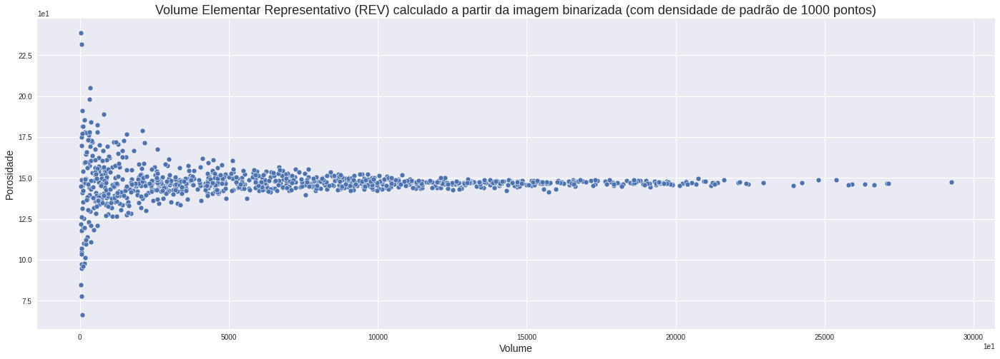

In [ ]:
#Aplicar função da biblioteca Porespy que calcula o REV a partir da imagem binarizada:
profile_otsu = ps.metrics.representative_elementary_volume(img_otsu)

#Criação do Canva para plot do gráfico:
fig, ax = plt.subplots(figsize = (24, 8), ncols = 1)

#Plot do REV retirado da imagem binarizada
ax = sns.scatterplot(profile_otsu.volume, profile_otsu.porosity)

ax.set_title('Volume Elementar Representativo (REV) calculado a partir da imagem binarizada (com densidade de padrão de 1000 pontos)', fontsize = 18)
ax.set_xlabel('Volume', fontsize = 14)
ax.set_ylabel('Porosidade', fontsize = 14)

ax.ticklabel_format(style = 'sci', scilimits = (1, 1), axis = 'both')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0, 0.5, 'Porosidade')

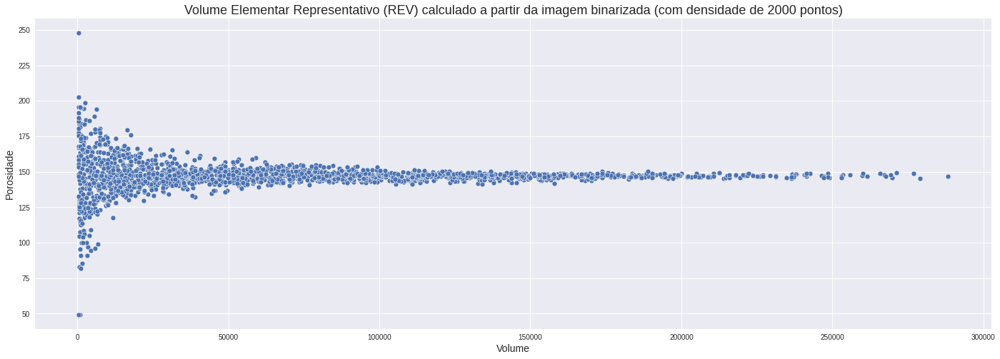

In [ ]:
#Teste com um número de amostras maior em relação a análise anterior:
profile_otsu = ps.metrics.representative_elementary_volume(img_otsu, npoints = 2000)

fig, ax = plt.subplots(figsize = (24, 8), ncols = 1)

#Plot do REV retirado da imagem binarizada
ax = sns.scatterplot(profile_otsu.volume, profile_otsu.porosity)
ax.set_title('Volume Elementar Representativo (REV) calculado a partir da imagem binarizada (com densidade de 2000 pontos)', fontsize = 18)
ax.set_xlabel('Volume', fontsize = 14)
ax.set_ylabel('Porosidade', fontsize = 14)